In [1]:
import torch, torch.nn.functional as F, random, wandb, time
import torchvision.transforms as T
import random
from torchvision import transforms
from diffusers import AutoencoderDC, SanaTransformer2DModel
from diffusers.schedulers import FlowMatchEulerDiscreteScheduler
from transformers import AutoModel, AutoTokenizer, set_seed
from datasets import load_dataset, Dataset, DatasetDict
from tqdm import tqdm
from torch.utils.data import DataLoader
from copy import deepcopy
from functools import partial

from utils import (
    linear_multistep_coeff,
    pil_add_text, 
    latent_to_PIL, 
    make_grid, 
    encode_prompt, 
    dcae_scalingf, 
    free_memory, 
    generate,
    generate_lms,
)

seed = 42
set_seed(seed)

/home/g/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


In [2]:
dtype = torch.bfloat16
device = "cuda" if torch.cuda.is_available() else "mps" if torch.mps.is_available() else "cpu"

transformer = SanaTransformer2DModel.from_pretrained(
    "g-ronimo/hana-alpha32"
).to(device).to(dtype)
text_encoder = AutoModel.from_pretrained("answerdotai/ModernBERT-large", torch_dtype=dtype).to(device)
tokenizer = AutoTokenizer.from_pretrained("answerdotai/ModernBERT-large", torch_dtype=dtype)
dcae = AutoencoderDC.from_pretrained("Efficient-Large-Model/Sana_600M_1024px_diffusers", subfolder="vae", torch_dtype=dtype).to(device)

You are attempting to use Flash Attention 2.0 with a model not initialized on GPU. Make sure to move the model to GPU after initializing it on CPU with `model.to('cuda')`.


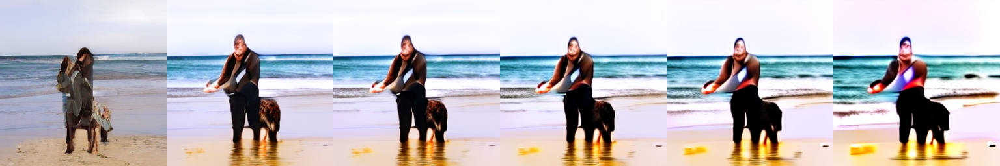

In [43]:
pipeline_components = dict(
    transformer=transformer,
    tokenizer=tokenizer,
    text_encoder=text_encoder,
    dcae=dcae,
)
inference_config = dict(
    # guidance_scale=7,
    latent_dim=[1, 32, 8, 8],
    latent_seed = 9221672424,
    num_steps=20
)

prompt = "a woman and her dog on the beach"

make_grid([
    generate(prompt, guidance_scale=2, **pipeline_components, **inference_config),
    generate(prompt, guidance_scale=5, **pipeline_components, **inference_config),
    generate(prompt, guidance_scale=6, **pipeline_components, **inference_config),
    generate(prompt, guidance_scale=7, **pipeline_components, **inference_config),
    generate(prompt, guidance_scale=8, **pipeline_components, **inference_config),
    generate(prompt, guidance_scale=10, **pipeline_components, **inference_config),
])

In [59]:
pipeline_components = dict(
    transformer=transformer,
    tokenizer=tokenizer,
    text_encoder=text_encoder,
    dcae=dcae,
)
inference_config = dict(
    guidance_scale=7,
    latent_dim=[1, 32, 8, 8],
    # latent_seed = 9221672424,
    num_steps=20
)

prompts = [
    "a dog",
    "a dog with blue eyes",
    "a dog on the beach",
    "a dog in the swimming pool",
    "a shark in the ocean",
    "a blue airplane taking off at the airport",
    "a bird in the swimming pool",
    "a beautiful snowy mountain landscape",
    "a woman",
    "a woman and her dog on the beach",
    "a woman eating a cheeseburger",
    "an astronaut riding a rainbow unicorn",
]

num_imgs_per_label = len(prompts)

In [46]:
images = {p:[] for p in prompts}
x0s = {p: 
       [ {step:[] for step in range(inference_config["num_steps"])} 
        for _ in range(num_imgs_per_label) ]
    for p in prompts
}

for prompt in tqdm(prompts):
    imgs_xps_prompt = [
        generate(prompt, return_xps=True, **pipeline_components, **inference_config)
        for _ in range(num_imgs_per_label)
    ]
    images[prompt] = [img_xps[0] for img_xps in imgs_xps_prompt] # imgs_xps_prompt[0]=image, imgs_xps_prompt[1]=list of x0s 
    for img_no in range(num_imgs_per_label):
        for step in range(inference_config["num_steps"]):
            x0s[prompt][img_no][step] = imgs_xps_prompt[img_no][1][step]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [01:36<00:00,  8.03s/it]


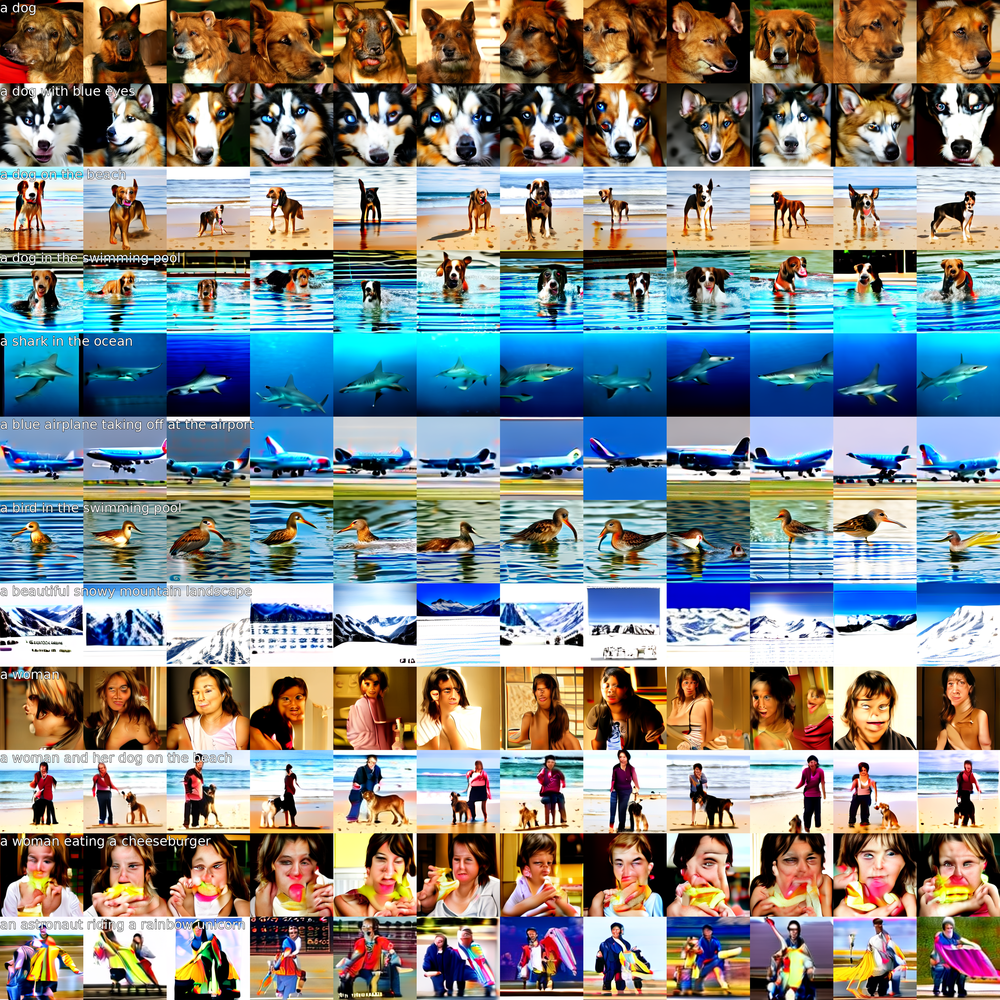

In [60]:
# gallery of all denoised images
gallery = make_grid([
    pil_add_text( make_grid(images[p]), p, font_size=40, position=(0,0))
    for p in prompts
], len(prompts), 1)
gallery.save("output.png")

gallery

In [48]:
# list of galleries of x predictions, one item per step
gallery_x0s = [
    make_grid([
        pil_add_text(
            make_grid([ x0s[prompt][img_no][step] for img_no in range(num_imgs_per_label)])
        , prompt)
        for prompt in prompts
    ], len(prompts), 1)
    for step in range(inference_config["num_steps"])
]

# original size
gif_anim = deepcopy(gallery_x0s)
gif_anim += [gif_anim[-1]]*15

gif_anim[-1].save("output.gif", save_all=True, append_images=gif_anim[1:-1], duration=100, loop=0)


In [49]:
# half size
gif_anim = deepcopy(gallery_x0s)
gif_anim = [i.resize((int(i.width//2.5), int(i.height//2.5))) for i in gif_anim]
gif_anim += [gif_anim[-1]]*15

gif_anim[-1].save("output_half.gif", save_all=True, append_images=gif_anim[1:-1], duration=100, loop=0)


In [56]:
prompt_selection = [
    prompts[0],
    prompts[2],
    prompts[4],
    prompts[6],
    prompts[8],
    prompts[9],
    prompts[10],
]
prompt_selection

['a dog',
 'a dog on the beach',
 'a shark in the ocean',
 'a bird in the swimming pool',
 'a woman',
 'a woman and her dog on the beach',
 'a woman eating a cheeseburger']

In [57]:
# x0 prediction gallery for selected prompts
num_inf_steps = 20
prompt_selection = [
    prompts[0],
    prompts[2],
    prompts[4],
    prompts[6],
    prompts[8],
    prompts[9],
    prompts[10],
]
num_imgs_per_label = len(prompt_selection)

gallery_x0s = [
    make_grid([
        pil_add_text(
            make_grid([ x0s[prompt][img_no][step] for img_no in range(num_imgs_per_label)])
        , prompt, font_size=40, stroke_width=2, position=(2,0))
        for prompt in prompt_selection
    ], len(prompt_selection), 1)
    for step in range(num_inf_steps)
]

# half size
gif_anim = deepcopy(gallery_x0s)
gif_anim = [i.resize((int(i.width//2), int(i.height//2))) for i in gif_anim]
gif_anim += [gif_anim[-1]]*15

gif_anim[-1].save("output_selected.gif", save_all=True, append_images=gif_anim[1:-1], duration=100, loop=0)

100%|█████████████████████████████████████████████████████| 12/12 [02:49<00:00, 14.11s/it]


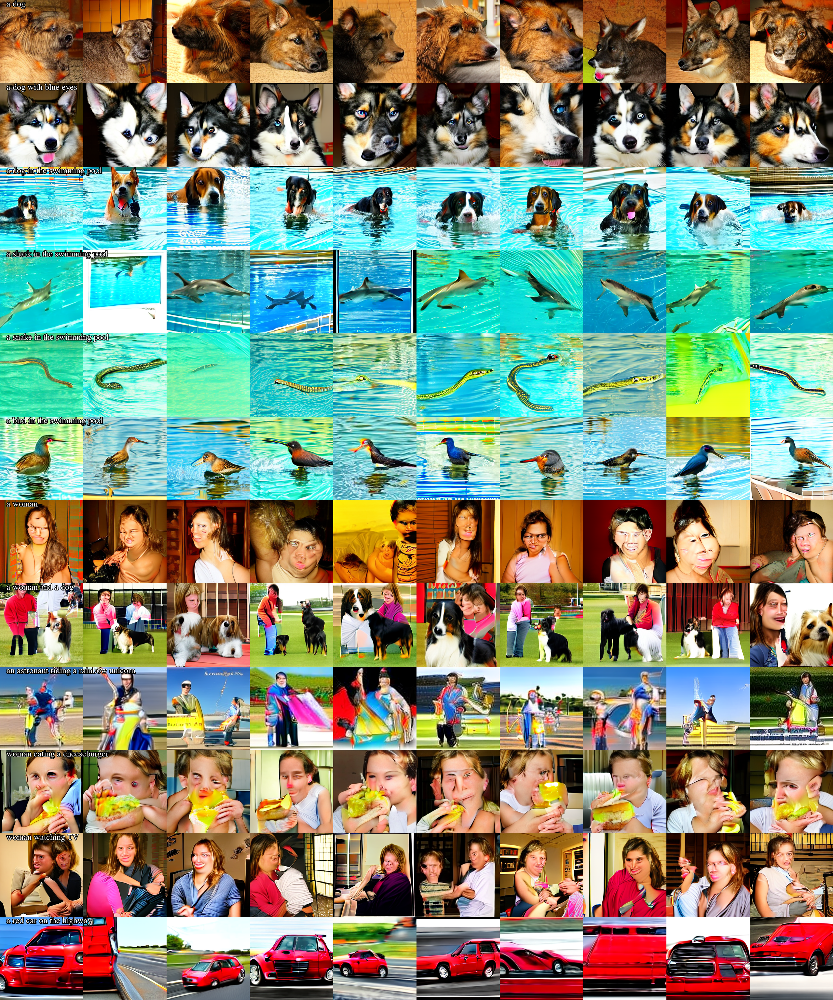

In [12]:
pipeline_components = dict(
    transformer=transformer,
    tokenizer=tokenizer,
    text_encoder=text_encoder,
    dcae=dcae,
)
inference_config = dict(
    guidance_scale=7,
    latent_dim=[1, 32, 8, 8],
    # latent_seed = 92421434324424,
    num_steps=10
)

prompts = [
    "a dog",
    "a dog with blue eyes",
    "a dog in the swimming pool",
    "a shark in the swimming pool",
    "a snake in the swimming pool",
    "a bird in the swimming pool",
    "a woman",
    "a woman and a dog",
    "an astronaut riding a rainbow unicorn",
    "woman eating a cheeseburger",
    "woman watching TV",
    "a red car on the highway",
]
num_imgs_per_label = 10
images = []
for prompt in tqdm(prompts):
    images_prompt = [
        generate(prompt, **pipeline_components, **inference_config)
        for _ in range(num_imgs_per_label)
    ]
    images_prompt = make_grid(images_prompt, 1, num_imgs_per_label)
    images_prompt = pil_add_text(images_prompt, prompt, stroke_width=2, position=(20,0))
    images.append(images_prompt)
make_grid(images, len(prompts), 1)